# Task 1: Introduction to NLP and Data Collection

## Using Kaggle API

In [1]:
# Install the Kaggle Python package for accessing datasets and competitions from Kaggle
! pip install -q kaggle

In [2]:
# Importing the files module from the Google Colab library
from google.colab import files

# Allow the user to upload files from their local machine, typically a `kaggle.json` API key file
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"minushaattygala","key":"df6bd4ac36412fb56f3591e6c487371f"}'}

In [3]:
# Create a directory named `.kaggle` in the home directory
! mkdir ~/.kaggle

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [4]:
# Move the `kaggle.json` file (which contains API credentials) to the `.kaggle` directory
! cp kaggle.json ~/.kaggle/

In [5]:
# Change the permissions of the `kaggle.json` file to ensure it's secure
# The file must have restricted access to work with the Kaggle API
! chmod 600 ~/.kaggle/kaggle.json

In [6]:
# List available datasets and competitions from Kaggle
# This confirms that the Kaggle API is set up correctly
! kaggle datasets list

ref                                                                    title                                                size  lastUpdated          downloadCount  voteCount  usabilityRating  
---------------------------------------------------------------------  --------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
bhadramohit/customer-shopping-latest-trends-dataset                    Customer Shopping (Latest Trends) Dataset            76KB  2024-11-23 15:26:12          15530        305  1.0              
hopesb/student-depression-dataset                                      Student Depression Dataset.                         454KB  2024-11-22 17:56:03          12335        158  1.0              
kanchana1990/uber-customer-reviews-dataset-2024                        Uber Customer Reviews Dataset (2024)                459KB  2024-12-19 19:05:47            638         30  1.0              
mujtabamatin/air-quality-

In [7]:
# Download the dataset
! kaggle datasets download clmentbisaillon/fake-and-real-news-dataset

Dataset URL: https://www.kaggle.com/datasets/clmentbisaillon/fake-and-real-news-dataset
License(s): CC-BY-NC-SA-4.0
 90% 37.0M/41.0M [00:00<00:00, 137MB/s] 
100% 41.0M/41.0M [00:00<00:00, 130MB/s]


In [8]:
# Unzip the downloaded dataset archive (fake-and-real-news-dataset.zip)
! unzip fake-and-real-news-dataset.zip

Archive:  fake-and-real-news-dataset.zip
  inflating: Fake.csv                
  inflating: True.csv                


In [9]:
# Importing the pandas library for data manipulation and analysis
import pandas as pd

In [10]:
# Reading the CSV file into a DataFrame
df_1 = pd.read_csv('/content/Fake.csv')

# Displaying the first 5 rows of the dataset to inspect its structure and content
# This helps in understanding the data columns and some sample values
df_1.head()

,title,text,subject,date
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017"
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017"
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017"
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017"
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017"


In [11]:
# Add a new column named 'label' and fill it with 'True'
df_1['label'] = 'Real'

# Displaying the first 5 rows of the dataset
df_1.head()

,title,text,subject,date,label
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",Real
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",Real
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",Real
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",Real
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",Real


In [12]:
# Displaying the shape of the DataFrame, which shows the number of rows and columns
# The output is a tuple (number_of_rows, number_of_columns)
# Useful for confirming the dataset size after modifications
df_1.shape

(23481, 5)

In [13]:
# Reading the CSV file into a DataFrame
df_2 = pd.read_csv('/content/True.csv')

# Displaying the first 5 rows of the dataset
df_2.head()

,title,text,subject,date
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017"
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017"
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017"
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017"
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017"


In [14]:
# Add a new column named 'label' and fill it with 'True'
df_2['label'] = 'Fake'

# Displaying the first 5 rows of the dataset
df_2.head()

,title,text,subject,date,label
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017",Fake
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017",Fake
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017",Fake
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017",Fake
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017",Fake


In [15]:
# Displaying the shape of the DataFrame, which shows the number of rows and columns
df_2.shape

(21417, 5)

In [16]:
# Concatenate the two dataframes vertically
df_merged = pd.concat([df_1, df_2], axis=0)

# Reset the index of the merged dataframe
df_merged = df_merged.reset_index(drop=True)

# Save the merged dataframe to a new CSV file named 'news.csv'
df_merged.to_csv('news.csv', index=False)

In [17]:
# Reading the CSV file into a DataFrame
df = pd.read_csv('/content/news.csv')

# Displaying the first 5 rows of the dataset
df.head()

,title,text,subject,date,label
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",Real
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",Real
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",Real
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",Real
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",Real


In [18]:
# Displaying the shape of the DataFrame, which shows the number of rows and columns
df.shape

(44898, 5)

In [19]:
# Check the distribution of labels
df['label'].value_counts()

,count
label,
Real,23481
Fake,21417


### Performing label encoding

In [20]:
# Add the new column which gives a unique number to each of these labels
df['label_num'] = df['label'].map({'Fake' : 0, 'Real': 1})

# Check the results with first 5 rows
df.head()

,title,text,subject,date,label,label_num
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",Real,1
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",Real,1
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",Real,1
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",Real,1
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",Real,1


In [21]:
# Check the results with last 5 rows
df.tail()

,title,text,subject,date,label,label_num
44893,'Fully committed' NATO backs new U.S. approach...,BRUSSELS (Reuters) - NATO allies on Tuesday we...,worldnews,"August 22, 2017",Fake,0
44894,LexisNexis withdrew two products from Chinese ...,"LONDON (Reuters) - LexisNexis, a provider of l...",worldnews,"August 22, 2017",Fake,0
44895,Minsk cultural hub becomes haven from authorities,MINSK (Reuters) - In the shadow of disused Sov...,worldnews,"August 22, 2017",Fake,0
44896,Vatican upbeat on possibility of Pope Francis ...,MOSCOW (Reuters) - Vatican Secretary of State ...,worldnews,"August 22, 2017",Fake,0
44897,Indonesia to buy $1.14 billion worth of Russia...,JAKARTA (Reuters) - Indonesia will buy 11 Sukh...,worldnews,"August 22, 2017",Fake,0


----------------------------------------------------------------------------------------------------------------------------------------------------

# Task 2: Text Preprocessing and Tokenization

- This task focuses on cleaning and transforming raw text data into a structured format for analysis.

## Tokenization

In [22]:
import nltk                                               # Importing the Natural Language Toolkit (nltk) library
nltk.download('punkt')                                    # Downloading the 'punkt' tokenizer models for sentence and word tokenization
from nltk.tokenize import sent_tokenize, word_tokenize    # Importing sentence and word tokenization methods from nltk
nltk.download('punkt_tab')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


True

In [23]:
# Loop through the first 5 rows of the dataframe
# `iterrows()` generates index and row data for each row
for index, row in df.head().iterrows():
    # Extracting the 'text' column from the current row
    extracted_message = row['text']
    # Tokenizing the extracted text into sentences
    sentences = sent_tokenize(extracted_message)

    # Iterating through each sentence in the list of sentences
    for sentence in sentences:
        # Tokenizing each sentence into words
        tokens = word_tokenize(sentence)
        print(f"Sentence: {sentence}")
        print(f"Tokens: {tokens}")
        print("-" * 80)              # Separator between sentences

Sentence: Donald Trump just couldn t wish all Americans a Happy New Year and leave it at that.
Tokens: ['Donald', 'Trump', 'just', 'couldn', 't', 'wish', 'all', 'Americans', 'a', 'Happy', 'New', 'Year', 'and', 'leave', 'it', 'at', 'that', '.']
--------------------------------------------------------------------------------
Sentence: Instead, he had to give a shout out to his enemies, haters and  the very dishonest fake news media.
Tokens: ['Instead', ',', 'he', 'had', 'to', 'give', 'a', 'shout', 'out', 'to', 'his', 'enemies', ',', 'haters', 'and', 'the', 'very', 'dishonest', 'fake', 'news', 'media', '.']
--------------------------------------------------------------------------------
Sentence: The former reality show star had just one job to do and he couldn t do it.
Tokens: ['The', 'former', 'reality', 'show', 'star', 'had', 'just', 'one', 'job', 'to', 'do', 'and', 'he', 'couldn', 't', 'do', 'it', '.']
--------------------------------------------------------------------------------
Se

In [24]:
# Define custom checks for the string tokens
for i, token in enumerate(tokens):
    print(token, "==>",
          "index: ", i,                        # Index of the token in the sentence
          "is_alpha:", token.isalpha(),        # True if the token consists of alphabetic characters
          "is_punct:", not token.isalnum(),    # True if the token is punctuation (using `isalnum` to check non-alphanumeric)
          "like_num:", token.isdigit(),        # True if the token represents a number
          "is_currency:", token in ['$', '€', '£', '¥'],  # True if the token is a currency symbol
          )

Amen ==> index:  0 is_alpha: True is_punct: False like_num: False is_currency: False
to ==> index:  1 is_alpha: True is_punct: False like_num: False is_currency: False
that.Photo ==> index:  2 is_alpha: False is_punct: True like_num: False is_currency: False
by ==> index:  3 is_alpha: True is_punct: False like_num: False is_currency: False
Christopher ==> index:  4 is_alpha: True is_punct: False like_num: False is_currency: False
Furlong/Getty ==> index:  5 is_alpha: False is_punct: True like_num: False is_currency: False
Images ==> index:  6 is_alpha: True is_punct: False like_num: False is_currency: False
. ==> index:  7 is_alpha: False is_punct: True like_num: False is_currency: False


## Remove stop words

In [25]:
import nltk
from nltk.corpus import stopwords     # Importing the `stopwords` corpus from nltk
nltk.download('stopwords')            # Downloading the stopwords corpus

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [26]:
# Fetching the English stop words as a set for fast lookup
stop_words = set(stopwords.words('english'))

# Printing the list of English stop words
print(stop_words)

{'what', 'on', 'ma', "wouldn't", 'into', 're', 'own', 'shan', 'himself', 'themselves', 'but', 'be', 'wouldn', 's', 'ours', 'have', "shan't", "hadn't", 'up', "needn't", 'why', 'of', 'as', "isn't", "didn't", 'further', 'its', 've', 'off', 'not', "you're", 'should', 'him', 'yourselves', 'me', 'has', 'too', 'won', 'their', 'who', 'was', "you'd", "hasn't", 'being', 'these', 'her', 'been', 'during', 'weren', 'ain', 'because', "couldn't", 'll', "you've", 'there', 'between', 'so', 'how', 'under', "don't", 'yourself', 'once', 'will', "mustn't", 'i', 'can', 'having', 'yours', 'you', 'itself', 'out', 'about', 'y', 'very', 'where', "it's", "you'll", 'a', 'the', 'it', 'in', 'each', 'or', 'd', 'all', 'above', 'when', 'herself', 'only', 'than', 'doesn', 'theirs', 'mightn', 'myself', 'm', 'aren', 'this', 'then', 'shouldn', 'now', 'were', 'if', 'below', 'mustn', 'some', "won't", 'such', 'until', "weren't", "mightn't", "should've", 'here', 'for', 'hasn', 'just', 'they', 'to', 'while', 'didn', 'ourselves

In [27]:
# Function to remove stop words from text
def remove_stopwords(text):
    words = word_tokenize(text)  # Tokenize the text into words
    filtered_words = [word for word in words if word.lower() not in stop_words]  # Remove stop words
    # Filtering out words that are in the stop words list
    return ' '.join(filtered_words)  # Join the filtered words back into a string

# Variables to count the total stop words and total words in the dataset
total_stopwords = 0
total_words = 0

for index, row in df.iterrows():
    text = row['text']                   # Extracting the 'text' column value from the current row
    doc = word_tokenize(text)            # Tokenizing the text into words
    for token in doc:
        # Checking if the token (word) is a stop word (case-insensitive)
        if token.lower() in stop_words:
            total_stopwords += 1
        total_words += 1

# Calculating the percentage of stop words in the dataset
if total_words > 0:
  stopword_percentage = (total_stopwords / total_words) * 100
else:
  stopword_percentage = 0

# Printing the total number of stop words and their percentage
print(f"Total Stop words: {total_stopwords}")
print(f"Percentage of Stop words: {stopword_percentage:.2f}%")

Total Stop words: 7762028
Percentage of Stop words: 38.13%


In [28]:
# Looping through the first 5 articles in the DataFrame
for i in range(5):          # Limit to the first 5 rows for processing
    text = df['text'][i]
    filtered_text = remove_stopwords(text)        # Removing stop words from the text
    print(f"Original Article {i}:\n{text}\n")
    print(f"Without Stop Words:\n{filtered_text}\n{'-' * 80}")

Original Article 0:
Donald Trump just couldn t wish all Americans a Happy New Year and leave it at that. Instead, he had to give a shout out to his enemies, haters and  the very dishonest fake news media.  The former reality show star had just one job to do and he couldn t do it. As our Country rapidly grows stronger and smarter, I want to wish all of my friends, supporters, enemies, haters, and even the very dishonest Fake News Media, a Happy and Healthy New Year,  President Angry Pants tweeted.  2018 will be a great year for America! As our Country rapidly grows stronger and smarter, I want to wish all of my friends, supporters, enemies, haters, and even the very dishonest Fake News Media, a Happy and Healthy New Year. 2018 will be a great year for America!  Donald J. Trump (@realDonaldTrump) December 31, 2017Trump s tweet went down about as welll as you d expect.What kind of president sends a New Year s greeting like this despicable, petty, infantile gibberish? Only Trump! His lack 

In [29]:
import string       # Importing the string module to access punctuation characters

# Create a new column for text without stop words
df['text_no_stopwords'] = df['text'].apply(remove_stopwords)

# Function to preprocess text: tokenizes, removes punctuation, and stop words
def preprocess_text(text):
    tokens = word_tokenize(text)
    # Remove punctuation
    tokens = [token for token in tokens if token not in string.punctuation]
    # Remove stop words
    tokens = [token for token in tokens if token.lower() not in stop_words]
    return tokens

# Create a new column with preprocessed tokens
df['processed_tokens'] = df['text_no_stopwords'].apply(preprocess_text)

# Create a dictionary to store word frequencies
word_frequencies = {}

# Calculate word frequencies for each row
for index, row in df.iterrows():
    tokens = row['processed_tokens']
    for token in tokens:
        token = token.lower()
        if token in word_frequencies:
            word_frequencies[token] += 1
        else:
            word_frequencies[token] = 1

# Find the word with the maximum frequency
max_frequency_word = max(word_frequencies, key=word_frequencies.get)
print(f"The word with the maximum frequency is '{max_frequency_word}' with a frequency of {word_frequencies[max_frequency_word]}.")

The word with the maximum frequency is 'said' with a frequency of 130194.


In [30]:
# Print the message "Processed DataFrame:"
print("\nProcessed DataFrame:")

# Display the first five rows
df.head()


Processed DataFrame:


,title,text,subject,date,label,label_num,text_no_stopwords,processed_tokens
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",Real,1,Donald Trump wish Americans Happy New Year lea...,"[Donald, Trump, wish, Americans, Happy, New, Y..."
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",Real,1,House Intelligence Committee Chairman Devin Nu...,"[House, Intelligence, Committee, Chairman, Dev..."
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",Real,1,"Friday , revealed former Milwaukee Sheriff Dav...","[Friday, revealed, former, Milwaukee, Sheriff,..."
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",Real,1,"Christmas day , Donald Trump announced would b...","[Christmas, day, Donald, Trump, announced, wou..."
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",Real,1,Pope Francis used annual Christmas Day message...,"[Pope, Francis, used, annual, Christmas, Day, ..."


## Lemmatization & Stemming

In [31]:
# Import the spaCy library for tasks like tokenization, part-of-speech tagging, named entity recognition, dependency parsing, and more.
import spacy

# Load the spaCy English language model
nlp = spacy.load("en_core_web_sm")

In [32]:
# Import PorterStemmer from NLTK for stemming (reducing words to their root form)
from nltk.stem import PorterStemmer

# Create an instance of the PorterStemmer
stemmer = PorterStemmer()

In [33]:
# Loop through each message to perform stemming and lemmatization
for index, row in df.head(5).iterrows():
  text = row['text']  # Process the message with SpaCy

  # Process the text with spaCy to create Doc object
  doc = nlp(text)

  # Tokenize the text using word_tokenize
  tokens = word_tokenize(text)

  # Apply stemming to each token using the PorterStemmer
  stemmed_tokens = [stemmer.stem(token) for token in tokens]

  # Apply lemmatization to each token using SpaCy (returns base form of the word)
  lemmatized_tokens = [token.lemma_ for token in doc]

  print(f"Original Message: {text}")
  print(f"Tokens: {tokens}")
  print(f"Stemmed Tokens: {stemmed_tokens}")
  print(f"Lemmatized Tokens: {lemmatized_tokens}")
  print("-" * 80)

Original Message: Donald Trump just couldn t wish all Americans a Happy New Year and leave it at that. Instead, he had to give a shout out to his enemies, haters and  the very dishonest fake news media.  The former reality show star had just one job to do and he couldn t do it. As our Country rapidly grows stronger and smarter, I want to wish all of my friends, supporters, enemies, haters, and even the very dishonest Fake News Media, a Happy and Healthy New Year,  President Angry Pants tweeted.  2018 will be a great year for America! As our Country rapidly grows stronger and smarter, I want to wish all of my friends, supporters, enemies, haters, and even the very dishonest Fake News Media, a Happy and Healthy New Year. 2018 will be a great year for America!  Donald J. Trump (@realDonaldTrump) December 31, 2017Trump s tweet went down about as welll as you d expect.What kind of president sends a New Year s greeting like this despicable, petty, infantile gibberish? Only Trump! His lack of

## N-grams

### Generate bigrams using CountVectorizer

In [34]:
# Import CountVectorizer from the sklearn.feature_extraction.text module for converting a collection of text documents into a matrix of token counts
from sklearn.feature_extraction.text import CountVectorizer

# Text data
documents = df['text_no_stopwords'].tolist()

# Create a CountVectorizer object
# ngram_range=(n, n) creates n-grams (e.g., (1, 1) for unigrams, (2, 2) for bigrams, (1, 2) for unigrams)
# max_features limits the number of features
vectorizer = CountVectorizer(ngram_range=(2, 2), max_features=10)  # Example: bigrams, top 10 features

# Fit and transform the text data
X = vectorizer.fit_transform(documents)

# Get the feature names (n-grams)
feature_names = vectorizer.get_feature_names_out()

# Print the n-grams and their counts
print("Generated bigrams:")
for i, ngram in enumerate(feature_names):
  print(f"{ngram}")

Generated bigrams:
donald trump
featured image
hillary clinton
new york
north korea
president donald
twitter com
united states
washington reuters
white house


In [35]:
# Convert the sparse matrix to a dense matrix (for demonstration purposes)
X_dense = X.toarray()

# Create a DataFrame to visualize the Bigrams and their counts
import pandas as pd
df_ngrams = pd.DataFrame(X_dense, columns=feature_names)

print("\nBigram Counts:")
print(df_ngrams.head())


Bigram Counts:
   donald trump  featured image  hillary clinton  new york  north korea  \
0             3               0                0         0            0   
1             0               0                2         2            0   
2             1               0                0         0            0   
3             2               0                0         0            0   
4             1               0                0         0            0   

   president donald  twitter com  united states  washington reuters  \
0                 0            1              0                   0   
1                 0            0              0                   0   
2                 0            6              0                   0   
3                 0            4              0                   0   
4                 0            0              0                   0   

   white house  
0            0  
1            0  
2            0  
3            0  
4            0  


----------------------------------------------------------------------------------------------------------------------------------------------------

# Task 3: POS Tagging and Named Entity Recognition (NER)

- To identify the grammatical structure of the text data and extract meaningful entities (like people, organizations, and locations) from the text.

## Part-of-Speech (POS) Tagging

In [36]:
import spacy

In [37]:
# Load the spaCy English language model
nlp = spacy.load("en_core_web_sm")

# Loop through each message to perform stemming and lemmatization
for index, row in df.head(5).iterrows():
  text = row['text']  # Process the message with SpaCy

doc = nlp(text) # tagger component, lemmatizer

for token in doc:
    print(token, " | ", spacy.explain(token.pos_), " | ", token.lemma_)

Pope  |  proper noun  |  Pope
Francis  |  proper noun  |  Francis
used  |  verb  |  use
his  |  pronoun  |  his
annual  |  adjective  |  annual
Christmas  |  proper noun  |  Christmas
Day  |  proper noun  |  Day
message  |  noun  |  message
to  |  particle  |  to
rebuke  |  verb  |  rebuke
Donald  |  proper noun  |  Donald
Trump  |  proper noun  |  Trump
without  |  adposition  |  without
even  |  adverb  |  even
mentioning  |  verb  |  mention
his  |  pronoun  |  his
name  |  noun  |  name
.  |  punctuation  |  .
The  |  determiner  |  the
Pope  |  proper noun  |  Pope
delivered  |  verb  |  deliver
his  |  pronoun  |  his
message  |  noun  |  message
just  |  adverb  |  just
days  |  noun  |  day
after  |  subordinating conjunction  |  after
members  |  noun  |  member
of  |  adposition  |  of
the  |  determiner  |  the
United  |  proper noun  |  United
Nations  |  proper noun  |  Nations
condemned  |  verb  |  condemn
Trump  |  proper noun  |  Trump
s  |  noun  |  s
move  |  noun  |

## Named Entity Recognition (NER)

In [38]:
doc = nlp(text)

for ent in doc.ents:
    print(ent.text, " | ", ent.label_, " | ", spacy.explain(ent.label_))

Francis  |  PERSON  |  People, including fictional
annual  |  DATE  |  Absolute or relative dates or periods
Christmas Day  |  DATE  |  Absolute or relative dates or periods
rebuke Donald Trump  |  PERSON  |  People, including fictional
the United Nations  |  ORG  |  Companies, agencies, institutions, etc.
Trump  |  ORG  |  Companies, agencies, institutions, etc.
Jerusalem  |  GPE  |  Countries, cities, states
Israel  |  GPE  |  Countries, cities, states
Monday  |  DATE  |  Absolute or relative dates or periods
two  |  CARDINAL  |  Numerals that do not fall under another type
Jesus  |  PERSON  |  People, including fictional
the Middle East  |  LOC  |  Non-GPE locations, mountain ranges, bodies of water
Israelis  |  NORP  |  Nationalities or religious or political groups
Palestinians  |  NORP  |  Nationalities or religious or political groups
Francis  |  PERSON  |  People, including fictional
this festive day  |  DATE  |  Absolute or relative dates or periods
Jerusalem  |  GPE  |  Count

In [39]:
from spacy import displacy # displacy library is a spacy  visualization tool which display named enitites in a document

displacy.render(doc, style="ent")

----------------------------------------------------------------------------------------------------------------------------------------------------

# Task 4: Sentiment Analysis

- To determine the overall sentiment or emotional tone expressed in the text data.

## Using TextBlob library

In [40]:
import nltk
from textblob import TextBlob   # Importing the TextBlob class from the textblob library, a simple NLP tool

In [41]:
# Function to get sentiment polarity
def get_sentiment(text):
  analysis = TextBlob(text)
  return analysis.sentiment.polarity

# Function to classify sentiment as positive, negative, or neutral
def classify_sentiment(polarity):
  if polarity > 0:
    return "Positive"
  elif polarity < 0:
    return "Negative"
  else:
    return "Neutral"

# Apply sentiment analysis to the 'text' column
df['sentiment_polarity'] = df['text'].apply(get_sentiment)
df['sentiment'] = df['sentiment_polarity'].apply(classify_sentiment)

# Display the first five rows with the sentiment analysis results
print(df[['text', 'sentiment_polarity', 'sentiment']].head().to_markdown(index=False))

| text                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  

In [42]:
# Distribution of Sentiments
sentiment_distribution = df['sentiment'].value_counts(normalize=True) * 100

print("Distribution of Sentiments:")
sentiment_distribution

Distribution of Sentiments:


,proportion
sentiment,
Positive,73.800615
Negative,22.524389
Neutral,3.674997


----------------------------------------------------------------------------------------------------------------------------------------------------

# Task 5: Topic Modeling

- To discover hidden thematic structures within the text data by grouping similar documents together.

## Using Latent Dirichlet Allocation (LDA) technique

In [43]:
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer

# Assuming 'df' is your DataFrame and 'text_no_stopwords' is the column with preprocessed text.
documents = df['text_no_stopwords'].tolist()

# Create a CountVectorizer object
vectorizer = CountVectorizer(max_df=0.95, min_df=2, stop_words='english')
dtm = vectorizer.fit_transform(documents)

# Define the number of topics
num_topics = 5  # Adjust as needed

# Create an LDA model
lda = LatentDirichletAllocation(n_components=num_topics, random_state=42)

# Fit the model to the document-term matrix
lda.fit(dtm)

# Get the top keywords for each topic
def get_top_keywords(model, feature_names, n_top_words):
    keywords_per_topic = []
    for topic_idx, topic in enumerate(model.components_):
        top_keywords = [feature_names[i] for i in topic.argsort()[:-n_top_words - 1:-1]]
        keywords_per_topic.append(top_keywords)
    return keywords_per_topic

n_top_words = 10  # Adjust as needed
feature_names = vectorizer.get_feature_names_out()
top_keywords = get_top_keywords(lda, feature_names, n_top_words)

# Print the topics and their keywords
for i, topic in enumerate(top_keywords):
    print(f"Topic {i + 1}: {', '.join(topic)}")

# Create a dictionary to store topic keywords
topics_dict = {}
for i, topic in enumerate(top_keywords):
    topics_dict[f"Topic {i+1}"] = topic

# Convert to DataFrame
topic_keywords_df = pd.DataFrame.from_dict(topics_dict, orient='index')
topic_keywords_df

Topic 1: said, trump, president, united, reuters, states, north, china, korea, new
Topic 2: said, police, state, government, people, syria, military, security, reuters, islamic
Topic 3: trump, said, clinton, campaign, president, election, republican, house, russia, presidential
Topic 4: trump, people, like, president, donald, twitter, said, obama, white, time
Topic 5: said, court, republican, state, law, republicans, tax, house, senate, vote


,0,1,2,3,4,5,6,7,8,9
Topic 1,said,trump,president,united,reuters,states,north,china,korea,new
Topic 2,said,police,state,government,people,syria,military,security,reuters,islamic
Topic 3,trump,said,clinton,campaign,president,election,republican,house,russia,presidential
Topic 4,trump,people,like,president,donald,twitter,said,obama,white,time
Topic 5,said,court,republican,state,law,republicans,tax,house,senate,vote


In [44]:
!pip install pyLDAvis

In [45]:
import gensim                                    # Used for topic modeling and document similarity analysis
from gensim import corpora                       # Work with dictionaries and corpora for topic modeling
from gensim.utils import simple_preprocess       # Used for text preprocessing (tokenization and cleaning)
from gensim.models import CoherenceModel         # Used to evaluate the coherence of topics in LDA

import pyLDAvis                                  # Visualize the topics in LDA models
import pyLDAvis.gensim                           # To make pyLDAvis compatible with gensim’s LDA model

# Suppressing deprecation warnings to avoid clutter in the output
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [46]:
# Define a function `gen_words` that takes a list of texts as input
def gen_words(texts):
    final = []        # Initialize an empty list `final` to store the processed words for each text
    for text in texts:
        # Use gensim's simple_preprocess to preprocess each text and remove accents (deacc=True)
        new = gensim.utils.simple_preprocess(text, deacc=True)
        final.append(new)
    return final

# Generate the list of processed words
data_words = gen_words(df['text_no_stopwords'])

# Print the first 20 words of the first processed document
print(data_words[0][0:20])

['donald', 'trump', 'wish', 'americans', 'happy', 'new', 'year', 'leave', 'instead', 'give', 'shout', 'enemies', 'haters', 'dishonest', 'fake', 'news', 'media', 'former', 'reality', 'show']


- This code processes a list of text documents by tokenizing them, converting all words to lowercase, removing punctuation, numbers, and accents then returns a list of lists containing the processed words.

In [47]:
# Bigrams & Trigrams
bigrams_phrases = gensim.models.Phrases(data_words, min_count=5, threshold=100)
trigrams_phrases = gensim.models.Phrases(bigrams_phrases[data_words], threshold=100)

# Create Phrasers for efficient processing
bigrams = gensim.models.phrases.Phraser(bigrams_phrases)
trigrams = gensim.models.phrases.Phraser(trigrams_phrases)

# Functions to apply bigrams and trigrams
def make_bigrams(texts):
    return [bigrams[doc] for doc in texts]

def make_trigrams(texts):
    return [trigrams[bigrams[doc]] for doc in texts]

data_bigrams = make_bigrams(data_words)
data_bigrams_trigrams = make_trigrams(data_bigrams)

# Print the trigrams for the first document
print(data_bigrams_trigrams[0])

['donald', 'trump', 'wish', 'americans', 'happy', 'new', 'year', 'leave', 'instead', 'give', 'shout', 'enemies', 'haters', 'dishonest', 'fake_news', 'media', 'former', 'reality', 'show', 'star', 'one', 'job', 'country', 'rapidly', 'grows', 'stronger', 'smarter', 'want', 'wish', 'friends', 'supporters', 'enemies', 'haters', 'even', 'dishonest', 'fake_news', 'media', 'happy', 'healthy', 'new', 'year', 'president', 'angry', 'pants', 'tweeted', 'great', 'year', 'america', 'country', 'rapidly', 'grows', 'stronger', 'smarter', 'want', 'wish', 'friends', 'supporters', 'enemies', 'haters', 'even', 'dishonest', 'fake_news', 'media', 'happy', 'healthy', 'new', 'year', 'great', 'year', 'america', 'donald', 'trump', 'realdonaldtrump', 'december', 'trump', 'tweet', 'went', 'welll', 'expect', 'what', 'kind', 'president', 'sends', 'new', 'year', 'greeting', 'like', 'despicable', 'petty', 'infantile', 'gibberish', 'trump', 'lack', 'decency', 'even', 'allow', 'rise', 'gutter', 'long', 'enough', 'wish',

### Creative Technique: TF-IDF (Term Frequency-Inverse Document Frequency) Removal for Topic Refinement

In [48]:
#TF-IDF removal
from gensim.models import TfidfModel

# Create a Dictionary from the bigrams and trigrams dataset
id2word = corpora.Dictionary(data_bigrams_trigrams)

# Create a bag-of-words (BoW) representation of the corpus
texts = data_bigrams_trigrams
corpus = [id2word.doc2bow(text) for text in texts]

print(corpus[0][0:20])

# Apply the TF-IDF model to the corpus
model = TfidfModel(corpus, id2word=id2word)

# Define a threshold value to filter out low-value terms (words with low TF-IDF scores)
low_value = 0.03
words = []
words_missing_in_tfidf = []

# Loop over each document in the corpus
for i in range(0, len(corpus)):
    bow = corpus[i]        # Get the BoW representation of the current document
    low_value_words = []   # List to store low-value words for the current document

    # Extract the word IDs that have a corresponding TF-IDF value
    tfidf_ids = [id for id, value in model[bow]]

    # Extract the word IDs from the original BoW representation
    bow_ids = [id for id, value in bow]

    # Identify words with TF-IDF values less than the defined threshold
    low_value_words = [id for id, value in model[bow] if value < low_value]

    # Combine the list of low-value words and the words that were missing from the TF-IDF model
    drops = low_value_words + words_missing_in_tfidf

    # Add the words that will be removed to the 'words' list
    for item in drops:
        words.append(id2word[item])

    # Update the list of words that are missing from the TF-IDF model
    words_missing_in_tfidf = [id for id in bow_ids if id not in tfidf_ids]

    # Remove low-value words and words missing in the TF-IDF model from the BoW representation
    new_bow = [b for b in bow if b[0] not in low_value_words and b[0] not in words_missing_in_tfidf]

    # Update the corpus with the new BoW representation for the current document
    corpus[i] = new_bow

# Print the words that have been removed due to low TF-IDF values
print(f"Words removed due to low TF-IDF scores: {words}")

[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 3), (7, 1), (8, 1), (9, 1), (10, 1), (11, 1), (12, 1), (13, 1), (14, 1), (15, 1), (16, 1), (17, 1), (18, 2), (19, 1)]
Words removed due to low TF-IDF scores: ['allow', 'also', 'always', 'american', 'americans', 'citizens', 'clearly', 'congress', 'control', 'country', 'donald', 'enough', 'former', 'give', 'got', 'here', 'include', 'including', 'instead', 'job', 'kind', 'know', 'last', 'leave', 'like', 'lost', 'love', 'make', 'many', 'men', 'nothing', 'one', 'people', 'pic_twitter_com', 'power', 'president', 'presidential', 'say', 'show', 'talk', 'term', 'this', 'voted', 'went', 'work', 'would', 'wrong', 'like', 'many', 'presidential', 'show', 'administration', 'around', 'campaign', 'day', 'election', 'going', 'help', 'may', 'said', 'us', 'world', 'breaking', 'donald', 'enough', 'even', 'former', 'friends', 'give', 'he', 'like', 'make', 'many', 'nothing', 'one', 'people', 'this', 'trump', 'tweeted', 'year_old', 'administration', 'fbi',

In [49]:
# Create an LDA model using the Gensim library
lda_model = gensim.models.ldamodel.LdaModel(
    corpus=corpus,          # The corpus is a list of documents in BoW (bag-of-words) format
    id2word=id2word,        # The dictionary mapping word IDs to actual words
    num_topics=7,           # The number of topics the model should identify
    random_state=100,       # Seed for random number generation to ensure reproducibility
    update_every=1,         # Number of iterations over the corpus before updating the model
    chunksize=100,          # Number of documents to be processed in each training chunk
    passes=10,              # Number of passes through the entire corpus during training
    alpha='auto'            # The alpha parameter, which affects the sparsity of the topic distribution. 'auto' adjusts it automatically.
)

In [50]:
# Enable visualization in Jupyter Notebook
pyLDAvis.enable_notebook()

# Parameters:
# - lda_model: The trained LDA model
# - corpus: The document-term matrix used for training
# - id2word: Dictionary mapping word IDs to actual words
# - mds: Method for dimensionality reduction; "mmds" is used for better clarity in visualization
# - R: Number of most relevant terms to display per topic
vis = pyLDAvis.gensim.prepare(lda_model, corpus, id2word, mds="mmds", R=30)

# Visualize the data
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.091508  0.026958       1        1  29.757162
0     -0.096708 -0.363263       2        1  21.274403
6     -0.369615 -0.123647       3        1  18.940378
4     -0.302118  0.290145       4        1  16.251116
5      0.262174 -0.282166       5        1   7.149677
3      0.413479  0.059870       6        1   4.593492
2      0.184296  0.392103       7        1   2.033773, topic_info=                                 Term          Freq         Total Category  \
265                              said  58863.000000  58863.000000  Default   
1444                            party  56039.000000  56039.000000  Default   
414                            police  19825.000000  19825.000000  Default   
995                             state  35412.000000  35412.000000  Default   
263                            russia  16364.000000  16364.000000  Default   
...                               ...           ...           ...      ...   
5546                            mayor   1483.493440   2124.990428   Topic7   
123                              star   1412.621779   2005.412156   Topic7   
28853  japanese_prime_minister_shinzo    546.076833    628.473131   Topic7   
2199                     social_media    730.445498   1698.943977   Topic7   
4864                             aged    500.104433    660.322124   Topic7   

       logprob  loglift  
265    30.0000  30.0000  
1444   29.0000  29.0000  
414    28.0000  28.0000  
995    27.0000  27.0000  
263    26.0000  26.0000  
...        ...      ...  
5546   -4.5901   3.5359  
123    -4.6390   3.5449  
28853  -5.5895   3.7547  
2199   -5.2986   3.0512  
4864   -5.6774   3.6174  

[355 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
7272      7  0.999791        abe
1814      1  0.241106    accused
1814      5  0.296190    accused
1814      6  0.462571    accused
1987      2  0.999558  activists
...     ...       ...        ...
158       6  0.590805   year_old
159       1  0.109952      years
159       3  0.404561      years
159       4  0.157651      years
159       6  0.327752      years

[499 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 1, 7, 5, 6, 4, 3])

----------------------------------------------------------------------------------------------------------------------------------------------------

# Task 6: Stylometric Analysis and Visualization

- To analyze the writing style characteristics of different text documents and potentially identify authorship or writing patterns.

In [51]:
# Import the PCA (Principal Component Analysis) class from sklearn.decomposition
# PCA is used for dimensionality reduction to visualize high-dimensional data
from sklearn.decomposition import PCA

# Import the KMeans clustering class from sklearn.cluster
# KMeans is used for clustering the data into distinct groups
from sklearn.cluster import KMeans

# Import Matplotlib's pyplot module for creating visualizations
import matplotlib.pyplot as plt


from sklearn.cluster import KMeans
import gensim

# Import the numpy library for numerical operations and array manipulations
import numpy as np

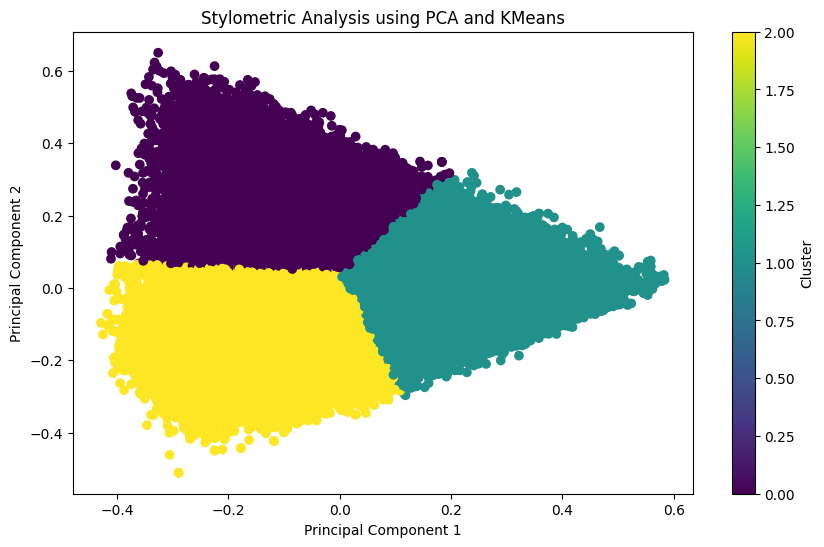

In [52]:
# Convert the document-topic matrix to a dense format for PCA and clustering
document_topic_matrix = lda_model[corpus]
dtm_dense = gensim.matutils.corpus2dense(document_topic_matrix, num_terms=lda_model.num_topics).T

# Apply PCA for dimensionality reduction
pca = PCA(n_components=2)  # Reduce to 2 dimensions for visualization
pca_result = pca.fit_transform(dtm_dense)

# Apply KMeans clustering
kmeans = KMeans(n_clusters=3, random_state=0)  # Experiment with different numbers of clusters
df['cluster'] = kmeans.fit_predict(pca_result)

# Visualization: PCA + KMeans
plt.figure(figsize=(10, 6))
plt.scatter(pca_result[:, 0], pca_result[:, 1], c=df['cluster'], cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Stylometric Analysis using PCA and KMeans')
plt.colorbar(label='Cluster')
plt.show()

- Documents within the same cluster are located closer together, indicating shared stylometric features.
- The overall visualization aims to showcase the differences and similarities in writing styles across the analyzed documents

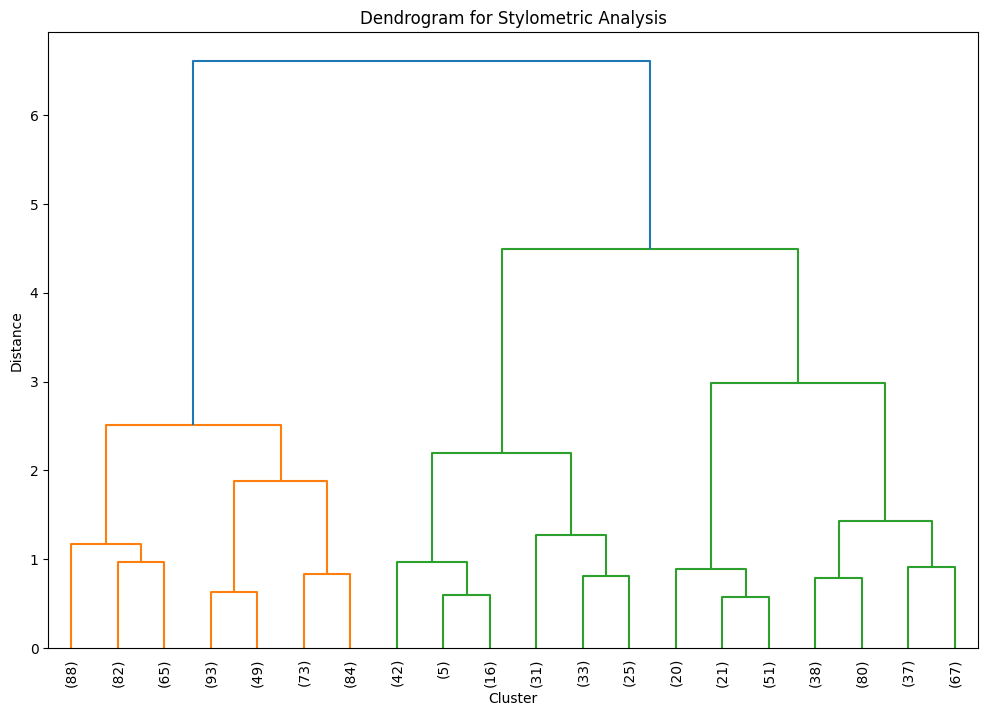

In [53]:
# Import the dendrogram and linkage functions from scipy.cluster.hierarchy
# - `linkage` is used to compute hierarchical clustering using a distance matrix
# - `dendrogram` is used to visualize the hierarchical clustering as a tree-like structure
from scipy.cluster.hierarchy import dendrogram, linkage

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Reduce dataset size for dendrogram
dtm_dense_sample = dtm_dense[:1000]  # Adjust based on memory constraints

# Reduce dimensions with PCA
pca = PCA(n_components=2, random_state=42)
dtm_dense_reduced = pca.fit_transform(dtm_dense_sample)

# Linkage for hierarchical clustering
linked = linkage(dtm_dense_reduced, method='ward')

# Generate the dendrogram
plt.figure(figsize=(12, 8))
dendrogram(linked,
           truncate_mode='lastp',  # Display only the last p clusters
           p=20,                   # Limit to 20 clusters
           show_leaf_counts=True,
           leaf_rotation=90.,
           leaf_font_size=10.)
plt.title('Dendrogram for Stylometric Analysis')
plt.xlabel('Cluster')
plt.ylabel('Distance')
plt.show()

- The dendrogram helps identify the optimal number of clusters by examining the major branches and their corresponding distances.
- It also provides insights into the relationships and hierarchies between the different writing styles present in the dataset.

----------------------------------------------------------------------------------------------------------------------------------------------------

# Task 7: Document Clustering with Word2Vec or Doc2Vec

- To group similar documents together based on their semantic meaning and underlying concepts.

In [54]:
# Import Word2Vec and Doc2Vec classes from gensim.models
# - `Word2Vec`: Used to create word embeddings, representing words as vectors in a continuous vector space
# - `Doc2Vec`: An extension of Word2Vec to generate embeddings for entire documents or paragraphs
from gensim.models import Word2Vec, Doc2Vec

# Import the TaggedDocument class from gensim.models.doc2vec
# - `TaggedDocument`: A utility class for associating documents with tags, required for training Doc2Vec models
from gensim.models.doc2vec import TaggedDocument

In [55]:
# Prepare data for Word2Vec/Doc2Vec
sentences = df['processed_tokens'].tolist()

# Word2Vec
model_w2v = Word2Vec(sentences, vector_size=100, window=5, min_count=1, workers=4)

# Convert documents to vectors (average of word vectors)
document_vectors_w2v = []
for tokens in sentences:
    vector = sum([model_w2v.wv[word] for word in tokens if word in model_w2v.wv]) / len(tokens) if len(tokens)>0 else [0] * 100  # Handle empty documents
    document_vectors_w2v.append(vector)


# Doc2Vec
tagged_data = [TaggedDocument(words=tokens, tags=[str(i)]) for i, tokens in enumerate(sentences)]
model_d2v = Doc2Vec(tagged_data, vector_size=100, window=5, min_count=1, workers=4)
document_vectors_d2v = [model_d2v.dv[i] for i in range(len(sentences))]


# KMeans Clustering (using Doc2Vec vectors)
kmeans = KMeans(n_clusters=5, random_state=0) # Adjust the number of clusters
df['cluster_d2v'] = kmeans.fit_predict(document_vectors_d2v)
print(df[['text', 'cluster_d2v']].head())

                                                text  cluster_d2v
0  Donald Trump just couldn t wish all Americans ...            1
1  House Intelligence Committee Chairman Devin Nu...            2
2  On Friday, it was revealed that former Milwauk...            1
3  On Christmas day, Donald Trump announced that ...            1
4  Pope Francis used his annual Christmas Day mes...            1


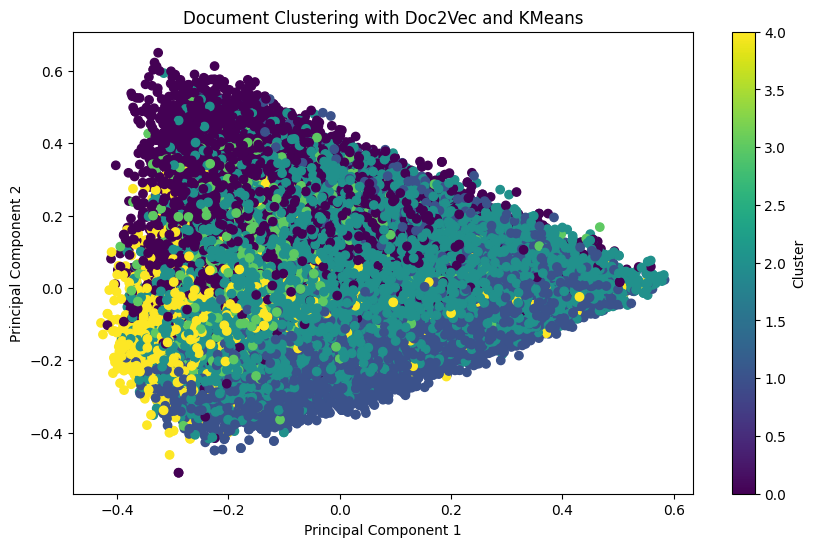

In [56]:
# Visualization
plt.figure(figsize=(10, 6))
plt.scatter(pca_result[:, 0], pca_result[:, 1], c=df['cluster_d2v'], cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Document Clustering with Doc2Vec and KMeans')
plt.colorbar(label='Cluster')
plt.show()

- The overall visualization aims to showcase the semantic similarities and differences across the analyzed documents, highlighting the underlying topics or themes present in the text data.

----------------------------------------------------------------------------------------------------------------------------------------------------

# Task 8: Dependency Parsing and Advanced Structures

- To understand the grammatical relationships between words in a sentence by identifying the dependencies and relationships between words in sentences.

In [57]:
# Sample Dependency Parsing using spaCy
import spacy
from spacy import displacy

nlp = spacy.load("en_core_web_sm")

In [58]:
# Parse a subset of the data (e.g., the first 10 rows)
for index, row in df.head(10).iterrows():
  text = row['text']
  doc = nlp(text)

  # Access dependency information for each token
  for token in doc:
    print(f"Token: {token.text}, Dependency: {token.dep_}, Head: {token.head.text}")

Token: Donald, Dependency: compound, Head: Trump
Token: Trump, Dependency: nsubj, Head: wish
Token: just, Dependency: advmod, Head: t
Token: couldn, Dependency: compound, Head: t
Token: t, Dependency: nsubj, Head: wish
Token: wish, Dependency: ROOT, Head: wish
Token: all, Dependency: det, Head: Americans
Token: Americans, Dependency: dative, Head: wish
Token: a, Dependency: det, Head: Year
Token: Happy, Dependency: compound, Head: Year
Token: New, Dependency: compound, Head: Year
Token: Year, Dependency: npadvmod, Head: wish
Token: and, Dependency: cc, Head: wish
Token: leave, Dependency: conj, Head: wish
Token: it, Dependency: dobj, Head: leave
Token: at, Dependency: prep, Head: leave
Token: that, Dependency: pobj, Head: at
Token: ., Dependency: punct, Head: wish
Token: Instead, Dependency: advmod, Head: had
Token: ,, Dependency: punct, Head: had
Token: he, Dependency: nsubj, Head: had
Token: had, Dependency: ROOT, Head: had
Token: to, Dependency: aux, Head: give
Token: give, Dependen

In [59]:
from spacy import displacy

for index, row in df.head(5).iterrows():  # Process the first 5 rows
    text = row['text']
    doc = nlp(text)
    displacy.render(doc, style="dep", jupyter=True)
    displacy.render(doc, style="ent", jupyter=True)

----------------------------------------------------------------------------------------------------------------------------------------------------

# Bonus Task: Implement an Advanced NLP Technique

## Text Summarization Using BART

- To generate concise and informative summaries of longer text documents.

- BART is a powerful pre-trained model known for its strong performance in abstractive text summarization, meaning it can generate summaries that paraphrase and reword the original text, rather than simply extracting sentences.

In [60]:
from transformers import pipeline         # For applying pre-trained Transformer-based models

summarizer = pipeline("summarization", model="facebook/bart-large-cnn")

# First 5 rows of DataFrame
for index, row in df.head(5).iterrows():
    text = row['text']
    summary = summarizer(text, max_length=130, min_length=30, do_sample=False)
    print(f"Original Text:\n{text[:500]}...\n") # Print first 500 characters of original text
    print(f"Summary:\n{summary[0]['summary_text']}\n{'*' * 80}")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Device set to use cpu


Original Text:
Donald Trump just couldn t wish all Americans a Happy New Year and leave it at that. Instead, he had to give a shout out to his enemies, haters and  the very dishonest fake news media.  The former reality show star had just one job to do and he couldn t do it. As our Country rapidly grows stronger and smarter, I want to wish all of my friends, supporters, enemies, haters, and even the very dishonest Fake News Media, a Happy and Healthy New Year,  President Angry Pants tweeted.  2018 will be a gr...

Summary:
Donald Trump tweeted a Happy New Year message to his enemies, haters and  the very dishonest fake news media. The former reality show star had just one job to do and he couldn't do it.
********************************************************************************
Original Text:
House Intelligence Committee Chairman Devin Nunes is going to have a bad day. He s been under the assumption, like many of us, that the Christopher Steele-dossier was what prompted the Russi